In [1]:
!wget https://datasets.cellxgene.cziscience.com/9042b53f-8c74-4a7d-af83-6d69d4b27fbd.h5ad

--2024-03-07 17:13:02--  https://datasets.cellxgene.cziscience.com/9042b53f-8c74-4a7d-af83-6d69d4b27fbd.h5ad
Resolving datasets.cellxgene.cziscience.com (datasets.cellxgene.cziscience.com)... 18.165.227.26, 18.165.227.61, 18.165.227.65, ...
Connecting to datasets.cellxgene.cziscience.com (datasets.cellxgene.cziscience.com)|18.165.227.26|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1391505374 (1.3G) [binary/octet-stream]
Saving to: ‘9042b53f-8c74-4a7d-af83-6d69d4b27fbd.h5ad’

9042b53f-8c74-4a7d- 100%[===================>]   1.30G  29.6MB/s    in 52s     

2024-03-07 17:13:55 (25.6 MB/s) - ‘9042b53f-8c74-4a7d-af83-6d69d4b27fbd.h5ad’ saved [1391505374/1391505374]



In [2]:
!mv 9042b53f-8c74-4a7d-af83-6d69d4b27fbd.h5ad Eraslan.h5ad

In [2]:
# enable autoreload
%load_ext autoreload
%autoreload 2
%matplotlib inline
%reload_ext autoreload

import os

import scvi
scvi.settings.seed = 0
import scanpy as sc
import anndata as ad
import torch
import numpy as np
import pandas as pd
from datetime import datetime
from scipy.sparse import csr_matrix
torch.set_float32_matmul_precision('medium')
import warnings
warnings.simplefilter("ignore", UserWarning)
import matplotlib.pyplot as plt

Global seed set to 0
Global seed set to 0


In [31]:
adata = sc.read_h5ad('Eraslan.h5ad')

In [32]:
def create_cats_idx(adata, cats):
    # create numerical index for each attr in cats

    for i in range(len(cats)):
        values = list(set(adata.obs[cats[i]]))

        val_to_idx = {v: values.index(v) for v in values}

        idx_list = [val_to_idx[v] for v in adata.obs[cats[i]]]

        adata.obs[cats[i] + '_idx'] = pd.Categorical(idx_list)

    return adata

In [33]:
adata

AnnData object with n_obs × n_vars = 209126 × 32922
    obs: 'Sample ID_prep', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'disease_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'n_genes', 'fpr', 'prep', 'individual', 'nGenes', 'nUMIs', 'PercentMito', 'PercentRibo', 'Age_bin', 'Sample ID', 'donor_id', 'Sample ID short', 'RIN score from PAXgene tissue Aliquot', 'RIN score from Frozen tissue Aliquot', 'Autolysis Score', 'Sample Ischemic Time (mins)', 'scrublet', 'scrublet_score', 'batch', 'n_counts', 'tissue-individual-prep', 'Broad cell type', 'Granular cell type', 'introns', 'junctions', 'exons', 'sense', 'antisense', 'intergenic', 'exon_ratio', 'intron_ratio', 'junction_ratio', 'log10_nUMIs', 'leiden', 'leiden_tissue', 'Tissue composition', 'Cell types level 2', 'Cell types level 3', 'Broad cell type numbers', 'Broad cell type (numbers)', 'channel', 'developm

In [34]:
adata.X.min(), adata.X.max()

(0.0, 8.578069)

In [35]:
adata.raw.X.min(),adata.raw.X.max()

(0.0, 9240.0)

In [36]:
adata.X = adata.raw.X.copy()

In [37]:
adata.obs.keys()

Index(['Sample ID_prep', 'assay_ontology_term_id',
       'cell_type_ontology_term_id', 'disease_ontology_term_id',
       'self_reported_ethnicity_ontology_term_id', 'is_primary_data',
       'organism_ontology_term_id', 'sex_ontology_term_id',
       'tissue_ontology_term_id', 'n_genes', 'fpr', 'prep', 'individual',
       'nGenes', 'nUMIs', 'PercentMito', 'PercentRibo', 'Age_bin', 'Sample ID',
       'donor_id', 'Sample ID short', 'RIN score from PAXgene tissue Aliquot',
       'RIN score from Frozen tissue Aliquot', 'Autolysis Score',
       'Sample Ischemic Time (mins)', 'scrublet', 'scrublet_score', 'batch',
       'n_counts', 'tissue-individual-prep', 'Broad cell type',
       'Granular cell type', 'introns', 'junctions', 'exons', 'sense',
       'antisense', 'intergenic', 'exon_ratio', 'intron_ratio',
       'junction_ratio', 'log10_nUMIs', 'leiden', 'leiden_tissue',
       'Tissue composition', 'Cell types level 2', 'Cell types level 3',
       'Broad cell type numbers', 'Broa

In [38]:
adata.obs['Age_bin']

Unnamed: 0
CST01_TAGGCATGTAAATACG-skeletalmuscle    51-60
CST01_CCTTACGTCCGTCAAA-skeletalmuscle    51-60
CST01_CACACTCCATGGAATA-skeletalmuscle    51-60
CST01_CCACTACGTGCAACGA-skeletalmuscle    51-60
CST01_GCAGTTAAGACTGTAA-skeletalmuscle    51-60
                                         ...  
TST03_TCGGTAAGTTGGGACA-skin              21-40
TST03_AGGGTGACAAGAAGAG-skin              21-40
TST03_GGGACCTCAAGTCTGT-skin              21-40
TST03_CACAGGCGTACATCCA-skin              21-40
TST03_GACCAATTCCAGTATG-skin              21-40
Name: Age_bin, Length: 209126, dtype: category
Categories (4, object): ['21-40', '41-50', '51-60', '61-70']

In [39]:
# preprocess dataset
sc.pp.filter_genes(adata, min_counts=3)
adata.layers["counts"] = adata.X.copy()
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.raw = adata
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=1200,
    subset=True,
    layer="counts",
    flavor="seurat_v3",
)

# specify name of dataset 
data_name = 'Eraslan'

# specify attributes
cats = ['tissue', 'Sample ID', 'cell_type', 'sex', 'Age_bin']

# create numerical index for each attr in cats
create_cats_idx(adata, cats)

# save adata
adata.write_h5ad('eraslan_preprocessed1200.h5ad')

today = datetime.today().strftime('%Y-%m-%d')

In [3]:
adata = sc.read_h5ad('eraslan_preprocessed1200_split.h5ad')
# adata = sc.read_h5ad('eraslan_preprocessed1200.h5ad')

In [25]:
import os

import scvi
scvi.settings.seed = 0
import scanpy as sc
import anndata as ad
import torch
import numpy as np
import pandas as pd
from datetime import datetime
from scipy.sparse import csr_matrix
torch.set_float32_matmul_precision('medium')
import warnings
warnings.simplefilter("ignore", UserWarning)

from dis2p_reproducibility.dis2p import dis2pvi_cE as dvi
# from scfair.evaluate import *
# from scfair_reproducibility.evaluation.metrics import *
# torch.autograd.set_detect_anomaly(True)

# today = datetime.today().strftime('%Y-%m-%d')
# data_name = 'Eraslan'
# adata = sc.read_h5ad('eraslan_preprocessed1200.h5ad')
# adata = adata[adata.X.sum(1) != 0].copy()

# cats = ['tissue', 'Sample ID', 'cell_type', 'sex', 'Age_bin']
# # cats = ['sex', 'Age_bin']

# # train params
# epochs = 1
# batch_size = 128
# cf_weight = 1
# beta = 1
# clf_weight = 50 # increase?
# adv_clf_weight = 10
# adv_period = 1
# n_cf = 1

# # architecture params
# n_layers=1

# train_dict = {'max_epochs': epochs, 'batch_size': batch_size, 'cf_weight': cf_weight,
#               'beta': beta, 'clf_weight': clf_weight, 'adv_clf_weight': adv_clf_weight,
#               'adv_period': adv_period, 'n_cf': n_cf}

# plan_kwargs={'lr': 1e-3}

# module_name = 'dis2p_cE'
# pre_path = f'models/{module_name}'
# if not os.path.exists(pre_path):
#     os.makedirs(pre_path)

# # specify a name for your model
# model_name =  f'{today},{module_name},{data_name},' + f'n_layers={n_layers},' + ','.join(k + '=' + str(v) for k, v in train_dict.items())

# # load model (if trained before)
# try:
#     model = dvi.Dis2pVI_cE.load(f"{pre_path}/{model_name}", adata=adata)
# # trains the model (if not trained before) and save it into: pre_path + model_name
# except:
#     print("Jumpt to except")
#     dvi.Dis2pVI_cE.setup_anndata(
#         adata,
#         layer='counts',
#         categorical_covariate_keys=cats,
#         continuous_covariate_keys=[]
#     )
#     model = dvi.Dis2pVI_cE(adata, n_layers=n_layers, gene_likelihood='zinb')
#     model.train(**train_dict, plan_kwargs=plan_kwargs, use_gpu=False)
#     model.save(f"{pre_path}/{model_name}")


Global seed set to 0


In [3]:
!ls

adib_train.py	       Eraslan.h5ad		      hp_tune_results  train.py
dis2p		       eraslan_preprocessed1200.h5ad  models
dis2p_env	       eraslan_preprocess.ipynb       __pycache__
dis2p_reproducibility  hp_tune.ipynb		      ray_train.py


In [4]:
pre_path = 'models/dis2p_cE/'
model_name = 'fine_tuned_regLoss_ood/'
model = dvi.Dis2pVI_cE.load(f"{pre_path}/{model_name}", adata=adata)

INFO     File models/dis2p_cE//fine_tuned_regLoss_ood/model.pt already downloaded                                  


An NVIDIA GPU may be present on this machine, but a CUDA-enabled jaxlib is not installed. Falling back to cpu.


In [36]:
!ls {pre_path}/{model_name}

model.pt


In [26]:
adata = sc.read_h5ad('eraslan_preprocessed1200.h5ad')
adata = adata[adata.X.sum(1) != 0].copy()

# today = datetime.today().strftime('%Y-%m-%d')
# data_name = 'Eraslan'
# module_name = 'dis2p_cE'

In [5]:
adata.obs.keys()

Index(['Sample ID_prep', 'assay_ontology_term_id',
       'cell_type_ontology_term_id', 'disease_ontology_term_id',
       'self_reported_ethnicity_ontology_term_id', 'is_primary_data',
       'organism_ontology_term_id', 'sex_ontology_term_id',
       'tissue_ontology_term_id', 'n_genes', 'fpr', 'prep', 'individual',
       'nGenes', 'nUMIs', 'PercentMito', 'PercentRibo', 'Age_bin', 'Sample ID',
       'donor_id', 'Sample ID short', 'RIN score from PAXgene tissue Aliquot',
       'RIN score from Frozen tissue Aliquot', 'Autolysis Score',
       'Sample Ischemic Time (mins)', 'scrublet', 'scrublet_score', 'batch',
       'n_counts', 'tissue-individual-prep', 'Broad cell type',
       'Granular cell type', 'introns', 'junctions', 'exons', 'sense',
       'antisense', 'intergenic', 'exon_ratio', 'intron_ratio',
       'junction_ratio', 'log10_nUMIs', 'leiden', 'leiden_tissue',
       'Tissue composition', 'Cell types level 2', 'Cell types level 3',
       'Broad cell type numbers', 'Broa

In [18]:

adata.obs['Broad cell type'].value_counts()

Broad cell type
Fibroblast                                   32421
Endothelial cell (vascular)                  21028
Myocyte (sk. muscle)                         20772
Epithelial cell (luminal)                    15956
Myocyte (smooth muscle)                      15680
Epithelial cell (basal)                      15594
Epithelial cell (alveolar type II)           15103
Immune (DC/macrophage)                       12959
Epithelial cell (alveolar type I)             7274
Myocyte (cardiac)                             7041
Immune (alveolar macrophage)                  5121
Pericyte/SMC                                  5083
Endothelial cell (lymphatic)                  4553
Epithelial cell (club)                        3669
Immune (T cell)                               3607
Epithelial cell (squamous)                    2771
Myocyte (cardiac, cytoplasmic)                2585
Epithelial cell (suprabasal)                  2404
Adipocyte                                     2350
Epithelial cell

In [17]:
# adata.obs[adata.obs['cell_type'] 
# list(adata.obs['cell_type'].unique())
adata.obs['cell_type']

Unnamed: 0
CST01_TAGGCATGTAAATACG-skeletalmuscle                     slow muscle cell
CST01_CCTTACGTCCGTCAAA-skeletalmuscle                     slow muscle cell
CST01_CACACTCCATGGAATA-skeletalmuscle                skeletal muscle fiber
CST01_CCACTACGTGCAACGA-skeletalmuscle    endothelial cell of vascular tree
CST01_GCAGTTAAGACTGTAA-skeletalmuscle    endothelial cell of vascular tree
                                                       ...                
TST03_TCGGTAAGTTGGGACA-skin                                 epidermal cell
TST03_AGGGTGACAAGAAGAG-skin                                 epidermal cell
TST03_GGGACCTCAAGTCTGT-skin                                 epidermal cell
TST03_CACAGGCGTACATCCA-skin                                 epidermal cell
TST03_GACCAATTCCAGTATG-skin                                 epidermal cell
Name: cell_type, Length: 209125, dtype: category
Categories (53, object): ['fibroblast', 'squamous epithelial cell', 'T cell', 'mast cell', ..., 'melanocyte of skin

In [21]:
adata[adata.obs['Broad cell type'] == 'Immune (T cell)'].obs['tissue'].value_counts()

tissue
mucosa                             1631
prostate gland                      614
lingula of left lung                613
anterior wall of left ventricle     357
esophagus muscularis mucosa         250
skin of leg                          75
gastrocnemius                        67
Name: count, dtype: int64

In [22]:
adata[adata.obs['Broad cell type'] == 'Immune (T cell)'].obs['sex'].value_counts()

sex
female    2270
male      1337
Name: count, dtype: int64

In [24]:
adata[(adata.obs['Broad cell type'] == 'Immune (T cell)') & (adata.obs['sex'] == 'male')].obs['tissue'].value_counts()

tissue
prostate gland                     614
lingula of left lung               268
esophagus muscularis mucosa        175
anterior wall of left ventricle    160
skin of leg                         75
gastrocnemius                       45
Name: count, dtype: int64

In [25]:
adata[(adata.obs['Broad cell type'] == 'Immune (T cell)') & (adata.obs['sex'] == 'female')].obs['tissue'].value_counts()

tissue
mucosa                             1631
lingula of left lung                345
anterior wall of left ventricle     197
esophagus muscularis mucosa          75
gastrocnemius                        22
Name: count, dtype: int64

In [8]:
model_1 = torch.load("models/dis2p_cE/2024-03-15,dis2p_cE,Eraslan,n_layers=1,max_epochs=80,batch_size=1024,cf_weight=1,beta=1,clf_weight=50,adv_clf_weight=10,adv_period=1,n_cf=1/model.pt", map_location='cpu')
# model_2 = torch.load(model_path + 'model.pt', map_location='cpu')

In [9]:
"px_r" in model_1["model_state_dict"].keys()

True

In [54]:
set(model_1["model_state_dict"].keys()).difference(set(model_2["model_state_dict"].keys()))

set()

In [45]:
model_state_dict = model_2["model_state_dict"]
var_names = model_2["var_names"]
attr_dict = model_2["attr_dict"]

In [46]:
"px_r" in model_state_dict.keys()

True

In [22]:
!ls models/dis2p_cE

'2024-03-15,dis2p_cE,Eraslan,n_layers=1,max_epochs=1,batch_size=128,cf_weight=1,beta=1,clf_weight=50,adv_clf_weight=10,adv_period=1,n_cf=1'


In [26]:
# load model
adata = sc.read_h5ad('eraslan_preprocessed1200.h5ad')
adata = adata[adata.X.sum(1) != 0].copy()

model_path = "models/dis2p_cE/loss950"
# model_path = "models/dis2p_cE/2024-03-15,dis2p_cE,Eraslan,n_layers=1,max_epochs=80,batch_size=1024,cf_weight=1,beta=1,clf_weight=50,adv_clf_weight=10,adv_period=1,n_cf=1/"
model = dvi.Dis2pVI_cE.load(model_path, adata=adata)
# cats = ['tissue', 'Sample ID', 'cell_type', 'sex', 'Age_bin']

INFO     File models/dis2p_cE/loss950/model.pt already downloaded                                                  


In [5]:
cats = ['tissue', 'Sample ID', 'cell_type', 'sex', 'Age_bin']

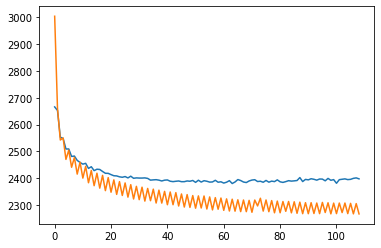

In [6]:
plt.plot(model.history['loss_validation'])
plt.plot(model.history['loss_train'])

In [7]:
model.device

device(type='cuda', index=0)

In [8]:
# Z_0
adata.obsm[f'dis2p_cE_Z_0'] = model.get_latent_representation(nullify_cat_covs_indices=[s for s in range(len(cats))], nullify_shared=False)

for i in range(len(cats)):
    null_idx = [s for s in range(len(cats)) if s != i]
    # Z_i
    adata.obsm[f'dis2p_cE_Z_{i+1}'] = model.get_latent_representation(nullify_cat_covs_indices=null_idx, nullify_shared=True)
    # Z_{-i}
    adata.obsm[f'dis2p_cE_Z_not_{i+1}'] = model.get_latent_representation(nullify_cat_covs_indices=[i], nullify_shared=False)

In [9]:
module_name = 'dis2p_cE'

In [10]:
adata.obsm[f'{module_name}'] = model.get_latent_representation(adata, nullify_cat_covs_indices=[0], nullify_shared=True)

In [ ]:
for i in range(len(cats) + 1):  # loop over all Z_i

    latent_name = f'dis2p_cE_Z_{i}'

    print(f"---UMAP for {latent_name}---")

    sc.pp.neighbors(adata, use_rep=f"{latent_name}")
    sc.tl.umap(adata)

    sc.pl.umap(
        adata,
        color=cats,
        ncols=len(cats),
        frameon=False,
    )

In [11]:
import random
sample = random.sample(range(len(adata)), 5000)

---UMAP for dis2p_cE_Z_0---


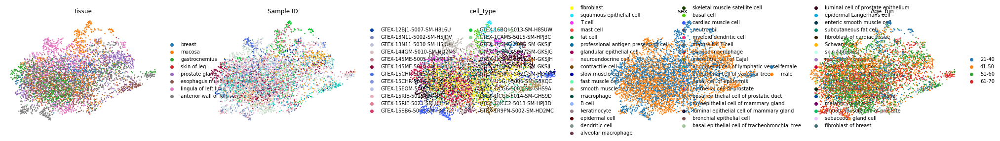

---UMAP for dis2p_cE_Z_1---
tissue


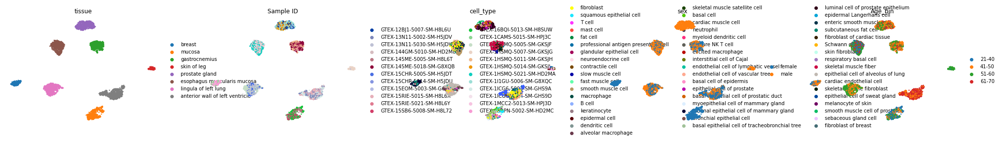

---UMAP for dis2p_cE_Z_2---
Sample ID


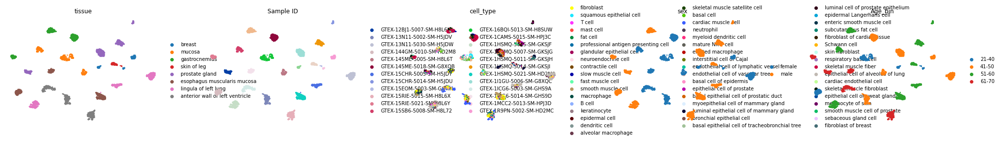

---UMAP for dis2p_cE_Z_3---
cell_type


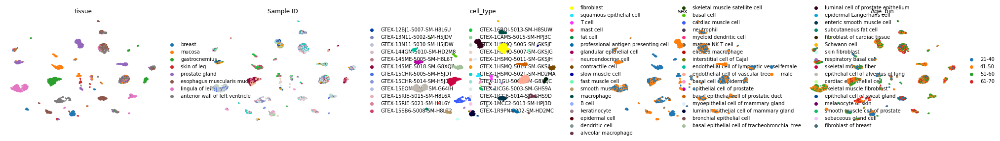

---UMAP for dis2p_cE_Z_4---
sex


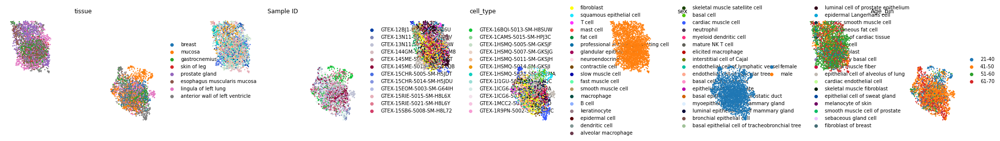

---UMAP for dis2p_cE_Z_5---
Age_bin


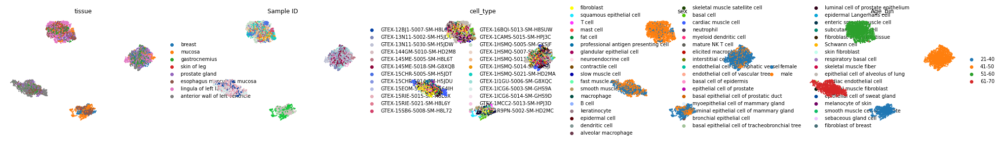

In [12]:
import warnings
warnings.filterwarnings("ignore")
cats = ['tissue', 'Sample ID', 'cell_type', 'sex', 'Age_bin']
nrow = len(cats) + 1
ncol = len(cats)
# fig, axs = plt.subplots(nrow, ncol, figsize=(2 * ncol, 2 * nrow))

for i in range(len(cats) + 1):  # loop over all Z_i
    latent_name = f'dis2p_cE_Z_{i}'

    print(f"---UMAP for {latent_name}---")
    if i != 0:
        print(cats[i - 1])
    adata_ = adata[sample]
    sc.pp.neighbors(adata_, use_rep=f"{latent_name}")
    sc.tl.umap(adata_)

    sc.pl.umap(
        adata_,
        color=cats,
        ncols=len(cats),
        frameon=False,
        # ax=axs[i][:]
    )


---UMAP for dis2p_cE_Z_0---


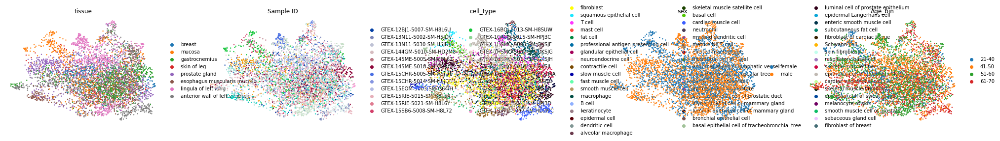

---UMAP for dis2p_cE_Z_1---
tissue


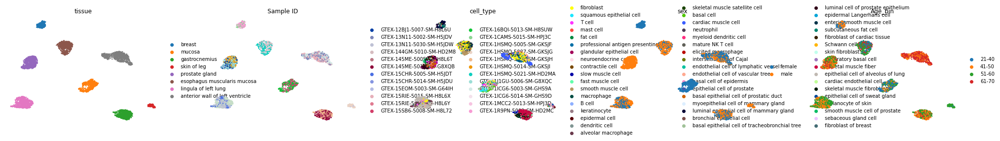

---UMAP for dis2p_cE_Z_2---
Sample ID


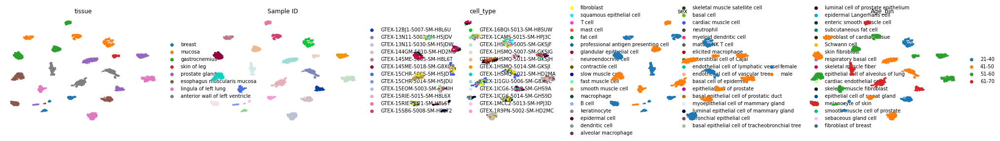

---UMAP for dis2p_cE_Z_3---
cell_type


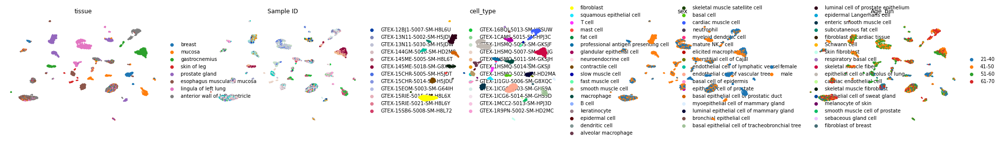

---UMAP for dis2p_cE_Z_4---
sex


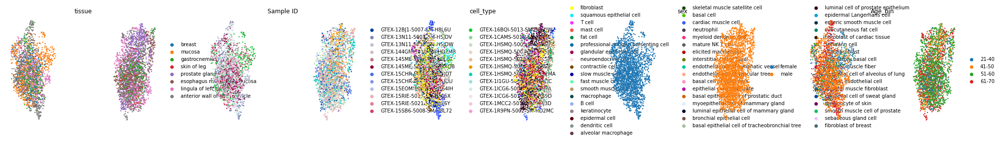

---UMAP for dis2p_cE_Z_5---
Age_bin


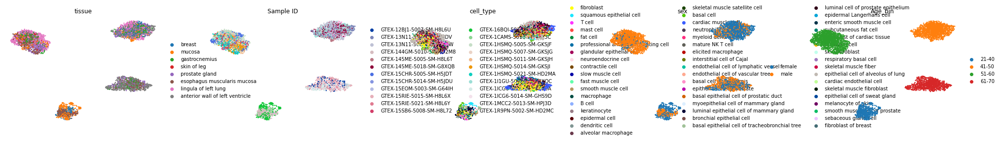

In [11]:
import warnings
warnings.filterwarnings("ignore")
cats = ['tissue', 'Sample ID', 'cell_type', 'sex', 'Age_bin']
nrow = len(cats) + 1
ncol = len(cats)
# fig, axs = plt.subplots(nrow, ncol, figsize=(2 * ncol, 2 * nrow))

for i in range(len(cats) + 1):  # loop over all Z_i
    latent_name = f'dis2p_cE_Z_{i}'

    print(f"---UMAP for {latent_name}---")
    if i != 0:
        print(cats[i - 1])
    adata_ = adata[sample]
    sc.pp.neighbors(adata_, use_rep=f"{latent_name}")
    sc.tl.umap(adata_)

    sc.pl.umap(
        adata_,
        color=cats,
        ncols=len(cats),
        frameon=False,
        # ax=axs[i][:]
    )


---UMAP for dis2p_cE_Z_0---


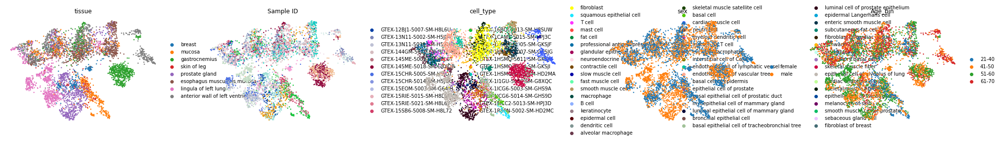

---UMAP for dis2p_cE_Z_1---
tissue


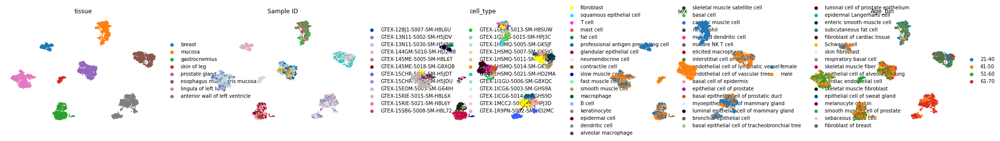

---UMAP for dis2p_cE_Z_2---
Sample ID


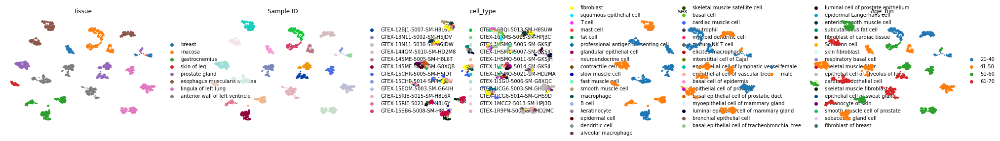

---UMAP for dis2p_cE_Z_3---
cell_type


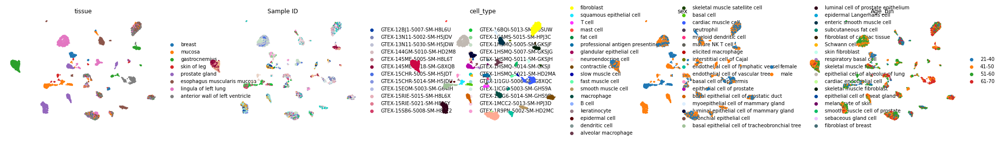

---UMAP for dis2p_cE_Z_4---
sex


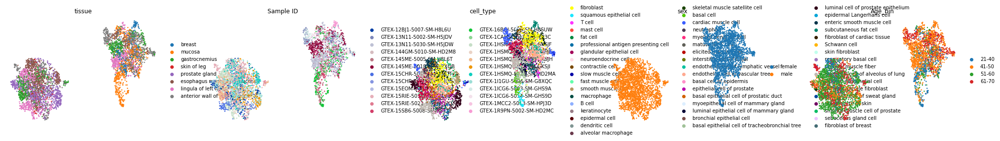

---UMAP for dis2p_cE_Z_5---
Age_bin


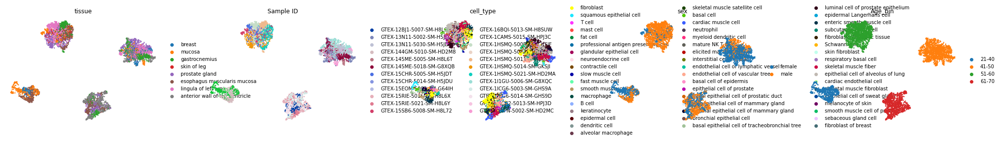

In [11]:
import warnings
warnings.filterwarnings("ignore")
cats = ['tissue', 'Sample ID', 'cell_type', 'sex', 'Age_bin']
nrow = len(cats) + 1
ncol = len(cats)
# fig, axs = plt.subplots(nrow, ncol, figsize=(2 * ncol, 2 * nrow))

for i in range(len(cats) + 1):  # loop over all Z_i
    latent_name = f'dis2p_cE_Z_{i}'

    print(f"---UMAP for {latent_name}---")
    if i != 0:
        print(cats[i - 1])
    adata_ = adata[sample]
    sc.pp.neighbors(adata_, use_rep=f"{latent_name}")
    sc.tl.umap(adata_)

    sc.pl.umap(
        adata_,
        color=cats,
        ncols=len(cats),
        frameon=False,
        # ax=axs[i][:]
    )


---UMAP for dis2p_cE_Z_0---


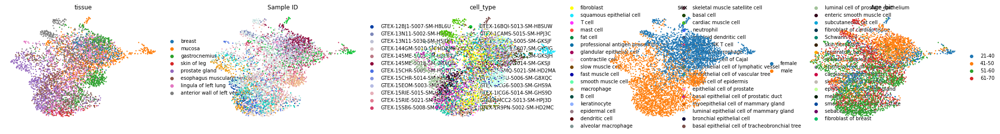

---UMAP for dis2p_cE_Z_1---
tissue


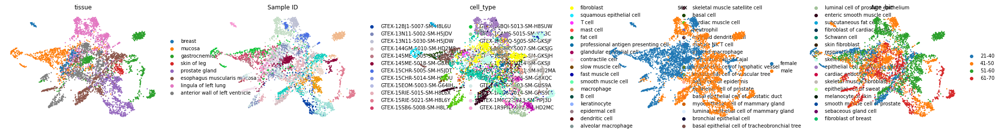

---UMAP for dis2p_cE_Z_2---
Sample ID


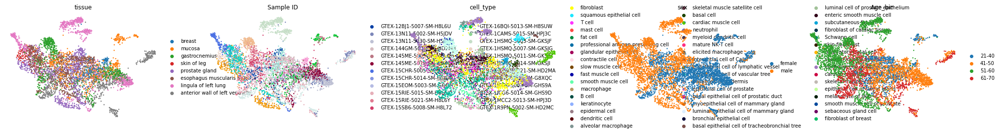

---UMAP for dis2p_cE_Z_3---
cell_type


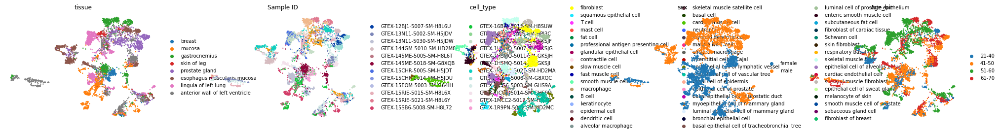

---UMAP for dis2p_cE_Z_4---
sex


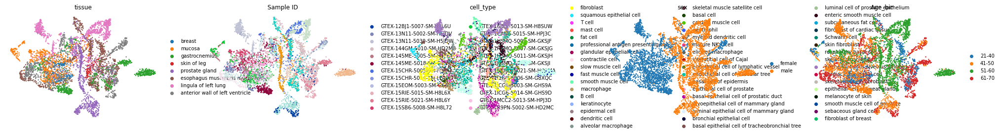

---UMAP for dis2p_cE_Z_5---
Age_bin


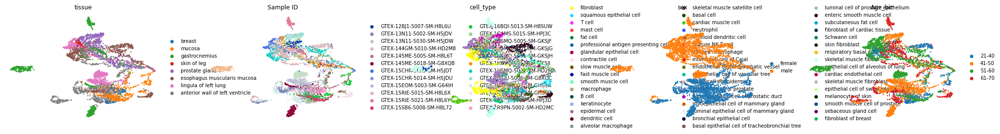

In [33]:
import warnings
warnings.filterwarnings("ignore")
cats = ['tissue', 'Sample ID', 'cell_type', 'sex', 'Age_bin']
nrow = len(cats) + 1
ncol = len(cats)
# fig, axs = plt.subplots(nrow, ncol, figsize=(2 * ncol, 2 * nrow))

for i in range(len(cats) + 1):  # loop over all Z_i
    latent_name = f'dis2p_cE_Z_{i}'

    print(f"---UMAP for {latent_name}---")
    if i != 0:
        print(cats[i - 1])
    adata_ = adata[sample]
    sc.pp.neighbors(adata_, use_rep=f"{latent_name}")
    sc.tl.umap(adata_)

    sc.pl.umap(
        adata_,
        color=cats,
        ncols=len(cats),
        frameon=False,
        # ax=axs[i][:]
    )


---UMAP for dis2p_cE_Z_0---


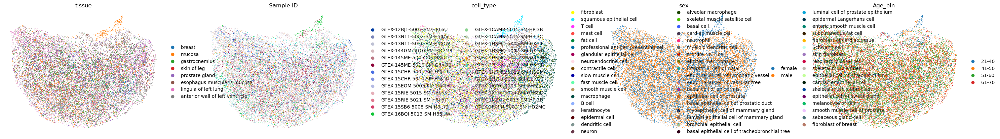

---UMAP for dis2p_cE_Z_1---


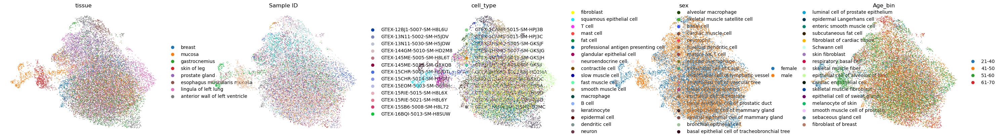

---UMAP for dis2p_cE_Z_2---


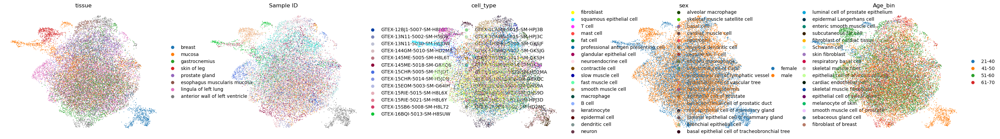

---UMAP for dis2p_cE_Z_3---


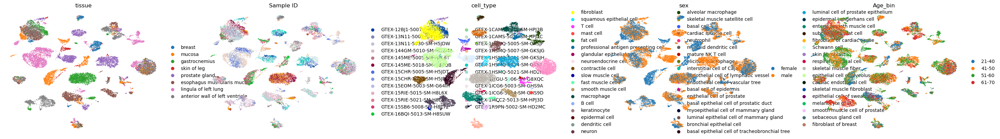

---UMAP for dis2p_cE_Z_4---


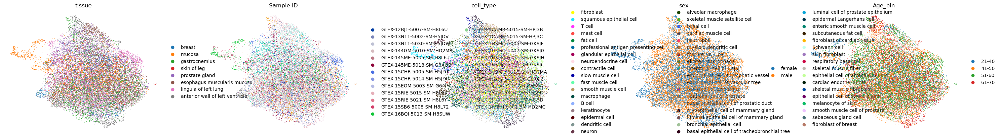

---UMAP for dis2p_cE_Z_5---


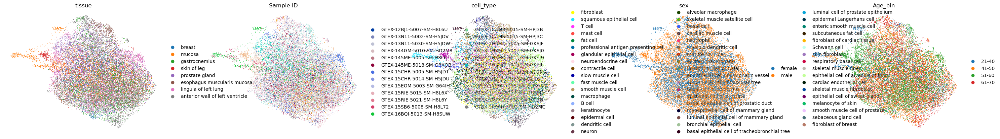

In [44]:
for i in range(len(cats) + 1):  # loop over all Z_i

    latent_name = f'dis2p_cE_Z_{i}'

    print(f"---UMAP for {latent_name}---")
    adata_ = adata[sample]
    sc.pp.neighbors(adata_, use_rep=f"{latent_name}")
    sc.tl.umap(adata_)

    sc.pl.umap(
        adata_,
        color=cats,
        ncols=len(cats),
        frameon=False,
    )
cats = ['tissue', 'Sample ID', 'cell_type', 'sex', 'Age_bin']


---UMAP for dis2p_cE_Z_0---


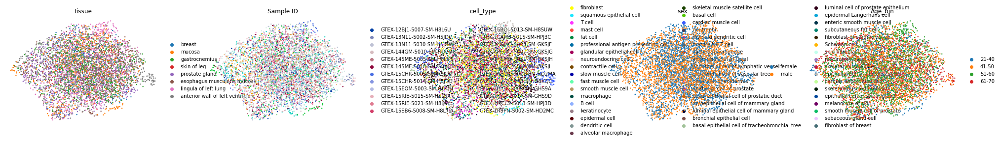

---UMAP for dis2p_cE_Z_1---


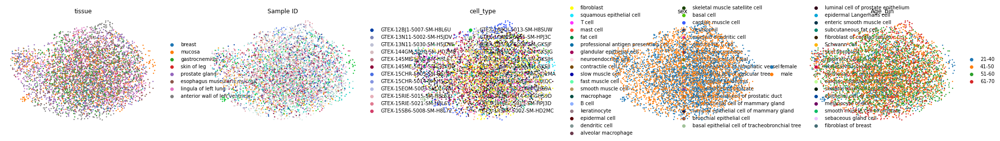

---UMAP for dis2p_cE_Z_2---


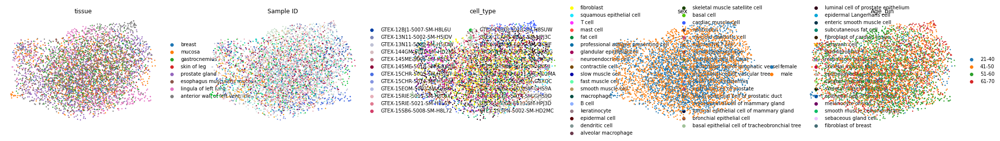

---UMAP for dis2p_cE_Z_3---


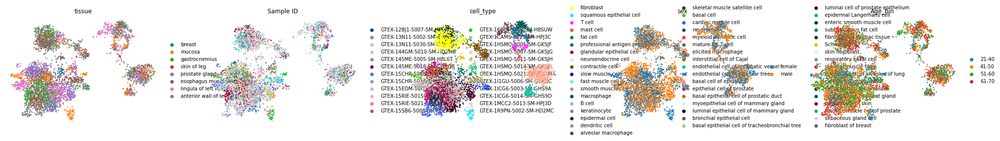

---UMAP for dis2p_cE_Z_4---


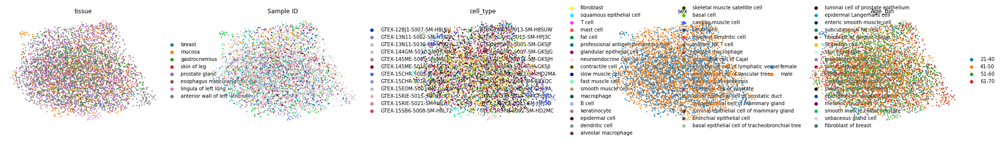

---UMAP for dis2p_cE_Z_5---


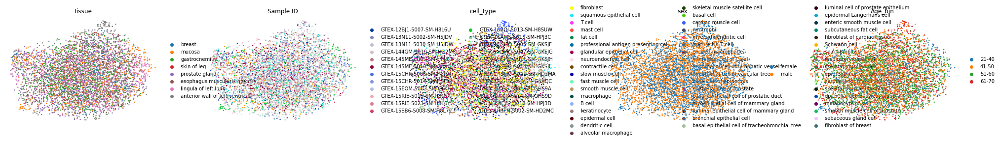

In [36]:
import warnings
warnings.filterwarnings("ignore")
for i in range(len(cats) + 1):  # loop over all Z_i

    latent_name = f'dis2p_cE_Z_{i}'

    print(f"---UMAP for {latent_name}---")
    adata_ = adata[sample]
    sc.pp.neighbors(adata_, use_rep=f"{latent_name}")
    sc.tl.umap(adata_)

    sc.pl.umap(
        adata_,
        color=cats,
        ncols=len(cats),
        frameon=False,
    )

In [3]:
# !cp -r /lustre/scratch126/cellgen/team205/aa34/Arian/Dis2p/tune_dis2p_Eraslan .

In [12]:
import sys
import os
import time

import numpy as np


from ray import tune, air
from ray.tune import CLIReporter
from ray.tune.schedulers import ASHAScheduler
from ray.tune.integration.pytorch_lightning import TuneReportCallback


In [13]:
from dis2p_reproducibility.dis2p import dis2pvi_cE as dvi
from ray.tune.integration.pytorch_lightning import TuneReportCallback
from ray.tune.schedulers import ASHAScheduler
from ray.tune import CLIReporter
from ray import tune, air
import warnings
from scipy.sparse import csr_matrix
from datetime import datetime
import pandas as pd
import numpy as np
import torch
import anndata as ad
import scanpy as sc
import os

import scvi

scvi.settings.seed = 0
torch.set_float32_matmul_precision('medium')
warnings.simplefilter("ignore", UserWarning)

DATA_NAME = 'Eraslan'


def train_fn(config, plan_keys=None, training_keys=None):

    adata = sc.read_h5ad('/lustre/scratch126/cellgen/team205/aa34/Arian/Dis2P/eraslan_preprocessed1200.h5ad')
    adata = adata[adata.X.sum(1) != 0].copy()
    sc.pp.subsample(adata, fraction=0.1)

    cats = ['tissue', 'Sample ID', 'cell_type', 'sex', 'Age_bin']

    dvi.Dis2pVI_cE.setup_anndata(
        adata,
        layer='counts',
        categorical_covariate_keys=cats,
        continuous_covariate_keys=[]
    )
    model = dvi.Dis2pVI_cE(adata,
                           n_layers=config['n_layers']
                           )

    x_loss = {f'x_{i}_validation': 0 for i in range(len(cats)+1)}
    z_loss = {f'z_{i}_validation': 0 for i in range(len(cats)+1)}
    metrics = {'loss_validation': 'loss_validation',
               'rec_x_validation': 'rec_x_validation',
               'ze_validation': 'ze_validation',
               'acc_validation': 'acc_validation',
               'f1_validation': 'f1_validation',
               'adv_ce_validation': 'adv_ce_validation',
               'adv_acc_validation': 'adv_acc_validation',
               'adv_f1_validation': 'adv_f1_validation'
               }
    metrics.update(x_loss)
    metrics.update(z_loss)
    callback = TuneReportCallback(metrics=metrics,
                                  on="validation_end")

    training_dict = {key: config[key] for key in training_keys}
    plan_kwargs = {key: config[key] for key in plan_keys}

    model.train(**training_dict,
                plan_kwargs=plan_kwargs,
                callbacks=[callback],
                )
    # model.save(f"{pre_path}/{model_name}")

training_params = {
    'max_epochs': tune.choice([50, 80, 100, 150]),
    'batch_size': tune.choice([512]),
    'cf_weight': tune.loguniform(1e-2, 1e2),
    'beta': tune.loguniform(1e-2, 1e2),
    'clf_weight': tune.loguniform(1e-2, 1e2),
    'adv_clf_weight': tune.loguniform(1e-2, 1e2),
    'adv_period': tune.choice([1, 2, 3]),
    'n_cf': tune.choice([1, 2, 3]),
}

plan_kwargs = {
    'lr': tune.loguniform(1e-5, 1e-2),
    'weight_decay': tune.loguniform(1e-6, 1e-3),
}


config = {'n_layers': tune.choice([1, 2, 3]),
          'n_hidden': tune.choice([128, 256, 512, 1024]),
          'n_latent_shared': tune.choice([10, 20, 30, 40, 50]),
          'n_latent_attribute': tune.choice([10, 20, 30, 40, 50]),
          'dropout_rate': tune.choice([0.1, 0.2, 0.3, 0.4, 0.5]),
          }
config.update(training_params)
config.update(plan_kwargs)

plan_keys = plan_kwargs.keys()
training_keys = training_params.keys()


logs_name = f"tune_dis2p_Eraslan"
# logs_name = "tune_cpa_combo_sciplex_s"
# experiment_path = os.path.join('/nfs/users/nfs_a/aa34/ray_results/', logs_name)
experiment_path = os.path.join('/lustre/scratch126/cellgen/team205/aa34/Arian/Dis2P/', logs_name)
print(f"Loading results from {experiment_path}...")

restored_tuner = tune.Tuner.restore(experiment_path, trainable=tune.with_resources(
        tune.with_parameters(
            train_fn,
            plan_keys=plan_keys,
            training_keys=training_keys,),
        resources={
            "cpu": 50,
            "gpu": 0.4
        }
    ),)
# result_grid = restored_tuner.get_results()


Global seed set to 0


Loading results from /lustre/scratch126/cellgen/team205/aa34/Arian/Dis2P/tune_dis2p_Eraslan...


2024-03-21 18:10:53,090	WARNING experiment_analysis.py:193 -- Failed to fetch metrics for 193 trial(s):
- train_fn_5c274_00246: FileNotFoundError('Could not fetch metrics for train_fn_5c274_00246: both result.json and progress.csv were not found at /lustre/scratch126/cellgen/team205/aa34/Arian/Dis2P/tune_dis2p_Eraslan/train_fn_5c274_00246_246_adv_clf_weight=0.2120,adv_period=3,batch_size=512,beta=20.0083,cf_weight=0.2105,clf_weight=0.0946,dropout_2024-03-21_13-47-49')
- train_fn_5c274_00271: FileNotFoundError('Could not fetch metrics for train_fn_5c274_00271: both result.json and progress.csv were not found at /lustre/scratch126/cellgen/team205/aa34/Arian/Dis2P/tune_dis2p_Eraslan/train_fn_5c274_00271_271_adv_clf_weight=0.3746,adv_period=2,batch_size=512,beta=39.9867,cf_weight=0.0882,clf_weight=1.9736,dropout_2024-03-21_14-16-04')
- train_fn_5c274_00160: FileNotFoundError('Could not fetch metrics for train_fn_5c274_00160: both result.json and progress.csv were not found at /lustre/scrat

In [14]:
result_grid = restored_tuner.get_results()


In [15]:
result_grid.get_best_result()

Result(
  metrics={'loss_validation': 1020.6328125, 'acc_validation': 0.25528454780578613, 'f1_validation': 0.25528454780578613, 'adv_ce_validation': 1.958751916885376, 'adv_acc_validation': 0.5876136422157288, 'adv_f1_validation': 0.5876136422157288},
  path='/lustre/scratch126/cellgen/team205/aa34/Arian/Dis2P/tune_dis2p_Eraslan/train_fn_5c274_00159_159_adv_clf_weight=0.0803,adv_period=2,batch_size=512,beta=0.0404,cf_weight=0.0214,clf_weight=0.0162,dropout__2024-03-21_12-56-00',
  filesystem='local',
  checkpoint=None
)

In [16]:
# Check if there have been errors
if result_grid.errors:
    print("One of the trials failed!")
else:
    print("No errors!")

One of the trials failed!


In [17]:
num_results = len(result_grid)
print("Number of results:", num_results)

Number of results: 406


In [18]:
# Iterate over results
for i, result in enumerate(result_grid):
    if result.error:
        print(f"Trial #{i} had an error:", result.error)
        continue

    print(
        f"Trial #{i} finished successfully with a mean accuracy metric of:",
        result.metrics["loss_validation"]
    )

Trial #0 finished successfully with a mean accuracy metric of: 1375.4420166015625


KeyError: 'loss_validation'

In [19]:
results_df = result_grid.get_dataframe()
results_df[["training_iteration", "loss_validation"]]

,training_iteration,loss_validation
0,20,1375.442017
1,5,1887.371704
2,5,28678.412109
3,5,5999.391113
4,5,2158.640869
...,...,...
182,5,15858.539062
183,5,3991.467529
184,5,3240.409424
185,5,2477.124512


In [20]:
from ray.train import Result

# Get the result with the maximum test set `mean_accuracy`
best_result: Result = result_grid.get_best_result()

# Get the result with the minimum `mean_accuracy`
worst_performing_result: Result = result_grid.get_best_result(
    metric="loss_validation", mode="max"
)

In [21]:
best_result.config


{'n_layers': 2,
 'n_hidden': 1024,
 'n_latent_shared': 40,
 'n_latent_attribute': 40,
 'dropout_rate': 0.5,
 'max_epochs': 150,
 'batch_size': 512,
 'cf_weight': 0.02135921989921178,
 'beta': 0.040363446353479895,
 'clf_weight': 0.016217680991790637,
 'adv_clf_weight': 0.0802735391795804,
 'adv_period': 2,
 'n_cf': 2,
 'lr': 0.0023673518422469976,
 'weight_decay': 0.00011452563864616767}

In [22]:
best_result.metrics


{'loss_validation': 1020.6328125,
 'acc_validation': 0.25528454780578613,
 'f1_validation': 0.25528454780578613,
 'adv_ce_validation': 1.958751916885376,
 'adv_acc_validation': 0.5876136422157288,
 'adv_f1_validation': 0.5876136422157288,
 'timestamp': 1711038720,
 'checkpoint_dir_name': None,
 'done': True,
 'training_iteration': 117,
 'trial_id': '5c274_00159',
 'date': '2024-03-21_16-32-00',
 'time_this_iter_s': 11.371881008148193,
 'time_total_s': 1034.4349460601807,
 'pid': 854105,
 'hostname': 'farm22-gpu0202',
 'node_ip': '10.160.31.11',
 'config': {'n_layers': 2,
  'n_hidden': 1024,
  'n_latent_shared': 40,
  'n_latent_attribute': 40,
  'dropout_rate': 0.5,
  'max_epochs': 150,
  'batch_size': 512,
  'cf_weight': 0.02135921989921178,
  'beta': 0.040363446353479895,
  'clf_weight': 0.016217680991790637,
  'adv_clf_weight': 0.0802735391795804,
  'adv_period': 2,
  'n_cf': 2,
  'lr': 0.0023673518422469976,
  'weight_decay': 0.00011452563864616767},
 'time_since_restore': 1034.4349

<Axes: xlabel='training_iteration'>

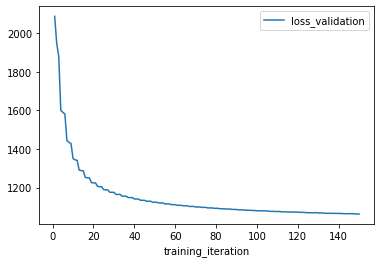

In [23]:
best_result.metrics_dataframe.plot("training_iteration", "loss_validation")

In [27]:
ax = None
for result in result_grid:
    label = f"lr={result.config['lr']:.3f}"
    if ax is None:
        ax = result.metrics_dataframe.plot("training_iteration", "loss_validation", label=label)
    else:
        result.metrics_dataframe.plot("training_iteration", "loss_validation", ax=ax, label=label)
ax.set_title("Mean Accuracy vs. Training Iteration for All Trials")
ax.set_ylabel("Mean Test Accuracy")

TypeError: 'NoneType' object is not subscriptable